In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import glob
from functools import reduce
import re as re
import datetime
from matplotlib.backends.backend_pdf import PdfPages
sns.set()


In [2]:
# Importing the file
for file in os.listdir("Data"):
    if file.endswith(".csv"):
        filepath = os.path.join("Data/", file)
df = pd.read_csv(filepath)

In [3]:
# Separating different protein states
FnCas12a = df[df['Protein State']=="FnCas12a"]
FnCas12a_crRNA = df[df['Protein State']=="FnCas12a-crRNA"]
FnCas12a_crRNA_activator = df[df['Protein State']=="FnCas12a-crRNA-activator"]
FnCas12a = FnCas12a.drop('Protein State', axis =1)
FnCas12a_crRNA = FnCas12a_crRNA.drop('Protein State', axis =1)
FnCas12a_crRNA_activator = FnCas12a_crRNA_activator.drop('Protein State', axis =1)

In [4]:
apo = FnCas12a.copy()
bi = FnCas12a_crRNA.copy()
tr = FnCas12a_crRNA_activator.copy()
frames = [apo, bi, tr]

In [5]:
# Combining all protein states so that it can be plotted together
df1 = reduce(lambda  left,right: pd.merge(left,right,on=['Start', 'End', 'Sequence', 'Deut Time (sec)', 'maxD'],
                                          how='outer'), frames)

In [15]:
df1.pepn_idx

idx_pep1
1 (7-13)                                  1. FVNKYSL (7-13)
1 (7-13)                                  1. FVNKYSL (7-13)
1 (7-13)                                  1. FVNKYSL (7-13)
1 (7-13)                                  1. FVNKYSL (7-13)
1 (7-13)                                  1. FVNKYSL (7-13)
2 (7-15)                                2. FVNKYSLSK (7-15)
2 (7-15)                                2. FVNKYSLSK (7-15)
2 (7-15)                                2. FVNKYSLSK (7-15)
2 (7-15)                                2. FVNKYSLSK (7-15)
2 (7-15)                                2. FVNKYSLSK (7-15)
3 (7-19)                            3. FVNKYSLSKTLRF (7-19)
3 (7-19)                            3. FVNKYSLSKTLRF (7-19)
3 (7-19)                            3. FVNKYSLSKTLRF (7-19)
3 (7-19)                            3. FVNKYSLSKTLRF (7-19)
3 (7-19)                            3. FVNKYSLSKTLRF (7-19)
4 (16-34)                    4. TLRFELIPQGKTLENIKAR (16-34)
4 (16-34)                    4.

In [6]:
# Renaming columns for clarity.
df1.columns = ['Start', 'End', 'Sequence', 'Deut Time (sec)', 'maxD', '#D_apo', '%D_apo',
       'Conf Interval (#D)_apo', '#Pts_apo', 'Confidence_apo', 'Stddev_apo', 'p_apo',
       '#D_bi', '%D_bi', 'Conf Interval (#D)_bi', '#Pts_bi', 'Confidence_bi',
       'Stddev_bi', 'p_bi', '#D_tr', '%D_tr', 'Conf Interval (#D)_tr', '#Pts_tr',
       'Confidence_tr', 'Stddev_tr', 'p_tr']


In [10]:
# indexing unique peptides from 1.
idx = range(1,1+len([i for i in df1['Sequence'].unique()]))

idx_dict = {idx: i for (idx, i) in zip(idx, df1['Sequence'].unique())}

df1['idx_pep'] = [idx for idx, pep in idx_dict.items() for p in df1['Sequence'] if p == pep]

df1['idx_pep1']= df1['idx_pep'].astype("str") + df1.Start.astype("str").apply(lambda x: " (" + x + "-") + df1.End.astype("str").apply(lambda x: x + ")")

# New Column containg the peptides, its unique index number and the start and end of the sequence

df1['pepn_idx'] = df1['idx_pep'].astype("str").apply(lambda x: x + ". ") + df1['Sequence'] + df1.Start.astype("str").apply(lambda x: " (" + x + "-") + df1.End.astype("str").apply(lambda x: x + ")")

# setting the idx_pep column as the index of the dataframe
df1.index = df1['idx_pep1']

# The differences in uptake of D betn binary and the ternary state
df1["delta(b,t)"] = df1['#D_bi']- df1['#D_tr']
df1["delta(a,b)"] = df1['#D_apo']- df1['#D_bi']

# Propagating the error
df1["delta(b,t),std"] = (df1['Stddev_bi']**2 + df1['Stddev_tr']**2).apply(np.sqrt)
df1["delta(a,b),std"] = (df1['Stddev_apo']**2 + df1['Stddev_bi']**2).apply(np.sqrt)


In [ ]:
pos_pep

In [9]:
# Fishing out Positive and Negative Changes
# I intentionally codded everything in one line just to practice my skill
pos_pep = df1.pepn_idx.unique()[df1.groupby("idx_pep")["#D_bi", "#D_tr"].mean()['#D_bi']>df1.groupby("idx_pep")["#D_bi", "#D_tr"].mean()['#D_tr']]
neg_pep = df1.pepn_idx.unique()[df1.groupby("idx_pep")["#D_bi", "#D_tr"].mean()['#D_bi']<df1.groupby("idx_pep")["#D_bi", "#D_tr"].mean()['#D_tr']]

# Fishing out indexes Positive and Negative Changes
pos_pep_idx = df1.index.unique()[df1.groupby("idx_pep")["#D_bi", "#D_tr"].mean()['#D_bi']>df1.groupby("idx_pep")["#D_bi", "#D_tr"].mean()['#D_tr']]
neg_pep_idx = df1.index.unique()[df1.groupby("idx_pep")["#D_bi", "#D_tr"].mean()['#D_bi']<df1.groupby("idx_pep")["#D_bi", "#D_tr"].mean()['#D_tr']]


In [16]:
df1.head()

,Start,End,Sequence,Deut Time (sec),maxD,#D_apo,%D_apo,Conf Interval (#D)_apo,#Pts_apo,Confidence_apo,...,Confidence_tr,Stddev_tr,p_tr,idx_pep,idx_pep1,pepn_idx,"delta(b,t)","delta(b,t),std","delta(a,b)","delta(a,b),std"
idx_pep1,,,,,,,,,,,,,,,,,,,,,
1 (7-13),7,13,FVNKYSL,10,5,0.658,13.157,0.229,2.0,Medium,...,Medium,0.043,0.011209,1,1 (7-13),1. FVNKYSL (7-13),0.130,0.044385,0.357,0.028231
1 (7-13),7,13,FVNKYSL,120,5,1.433,28.651,0.106,2.0,Medium,...,Medium,0.049,0.026255,1,1 (7-13),1. FVNKYSL (7-13),0.186,0.050220,0.453,0.016279
1 (7-13),7,13,FVNKYSL,600,5,2.425,48.508,3.174,2.0,Medium,...,Medium,0.012,0.098001,1,1 (7-13),1. FVNKYSL (7-13),0.127,0.097739,1.473,0.366085
1 (7-13),7,13,FVNKYSL,1800,5,2.880,57.594,NaN,1.0,Medium,...,Medium,0.090,1.000000,1,1 (7-13),1. FVNKYSL (7-13),0.048,0.138293,1.830,0.105000
1 (7-13),7,13,FVNKYSL,7200,5,3.084,61.682,3.650,2.0,Medium,...,Medium,0.067,0.080870,1,1 (7-13),1. FVNKYSL (7-13),0.269,0.067602,1.798,0.406100


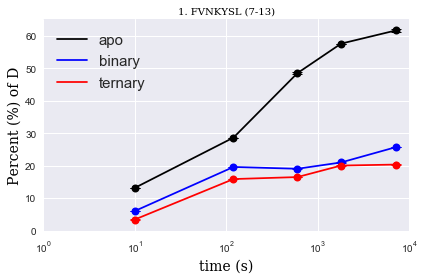

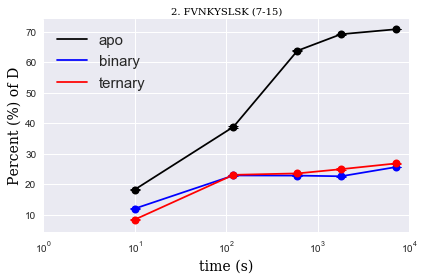

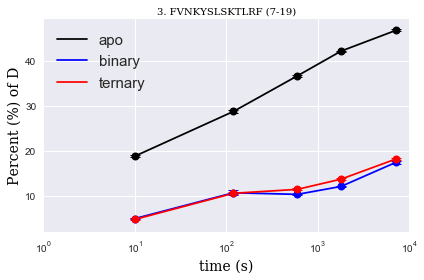

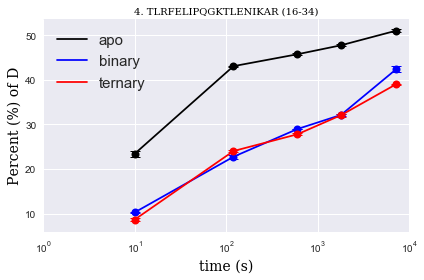

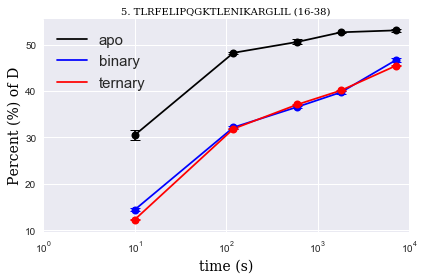

...

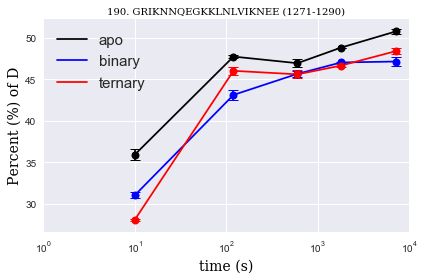

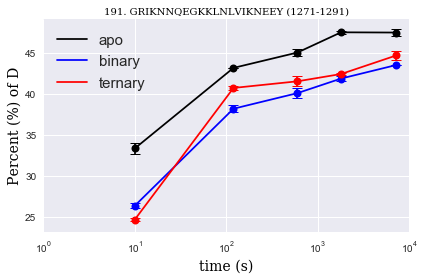

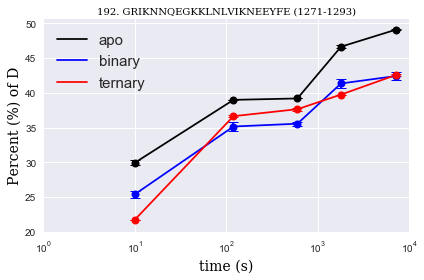

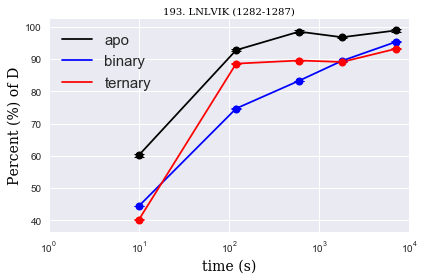

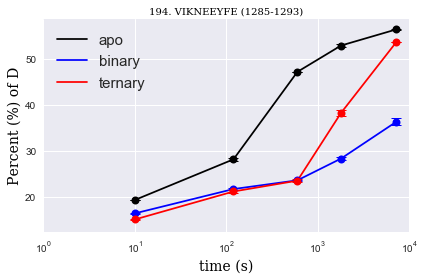

In [17]:
# Plotting all the uptake plots in terms of "%D"

with PdfPages('FnCas12a_uptake_plots_percent_D.pdf') as pdf: 
    
    peptides = [i for i in df1['pepn_idx'].unique()]

    for idx, p in zip(df1.idx_pep.unique(), peptides) :
        df2 = df1.loc[idx]

    # Create data

        a = (df2['Deut Time (sec)'], df2['%D_apo'])

        b = (df2['Deut Time (sec)'], df2['%D_bi'])

        c = (df2['Deut Time (sec)'], df2['%D_tr'])

        #plt.errorbar(x, y, yerr=e, fmt='o')
        a_std =  df2['Stddev_apo'].values.tolist()
        b_std =  df2['Stddev_bi'].values.tolist()
        c_std =  df2['Stddev_tr'].values.tolist()

        errors = (a_std, b_std, c_std)

        data = (a, b, c)
        colors = ("black", "blue", "red")
        groups = ("apo",  "binary", "ternary") 

        # Create plot
        fig = plt.figure()
        ax = fig.add_subplot(1, 1,1)
        ax.set_xscale('log')

        for data, color, group, error in zip(data, colors, groups, errors):
            x, y = data
            ax.scatter(x, y, c=color, edgecolors='none', s=30, label = None )
            ax.plot(x,y,c=color, label = group)

            (_, caps, _) = ax.errorbar(x, y, yerr=error, fmt='o', markersize=8, capsize=5, label = None, c= color)

            for cap in caps:
                cap.set_markeredgewidth(1)


        plt.xlim(1, 10000)
        #plt.ylim(ymin=0)

        font = {'family': 'serif','color':  'black', 'weight': 'normal','size': 14}
        font_t = {'family': 'serif','color':  'black', 'weight': 'normal','size': 10}
        plt.rc("font") 


        plt.xlabel('time (s)', fontdict = font)
        plt.ylabel("Percent (%) of D",fontdict = font)


        plt.title(p ,fontdict = font_t)
        plt.legend(fontsize = 15,loc=2)


        plt.tight_layout()


        pdf.savefig()
        plt.show()


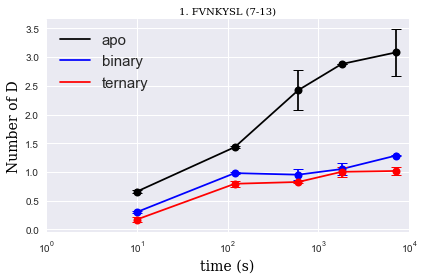

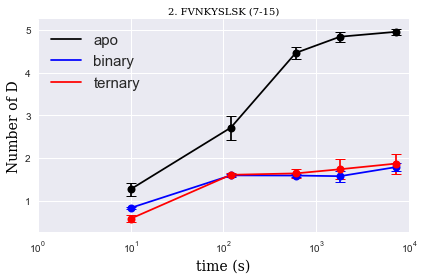

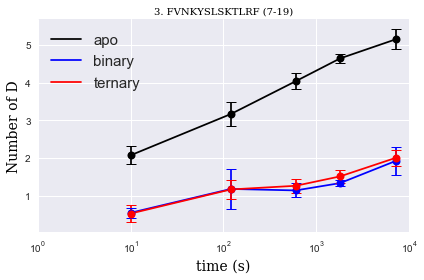

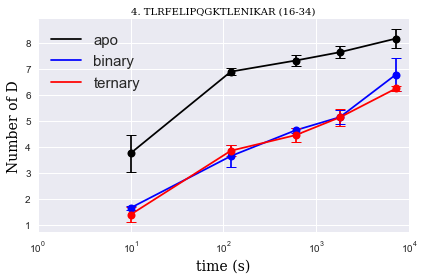

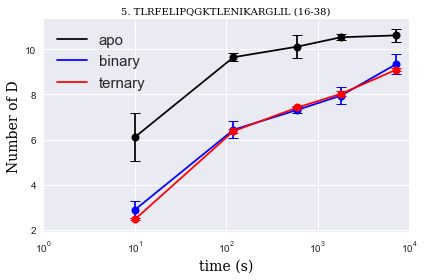

...

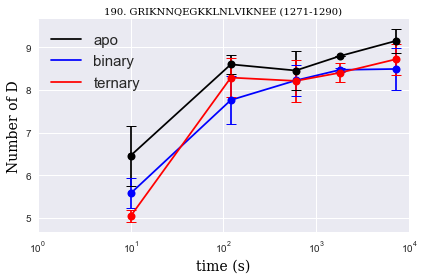

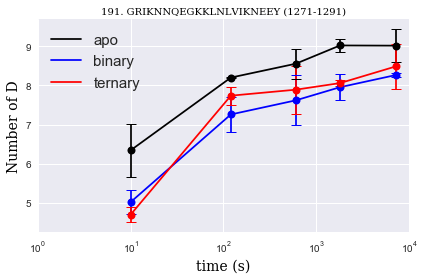

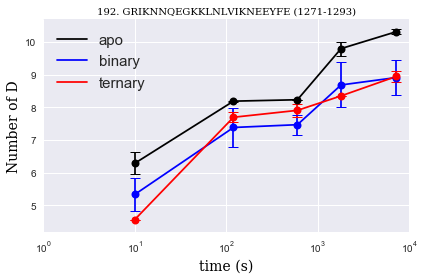

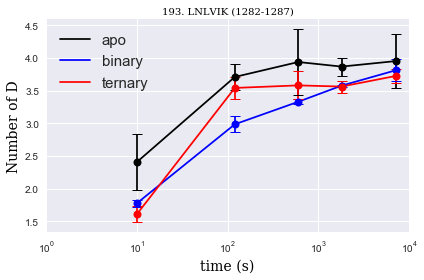

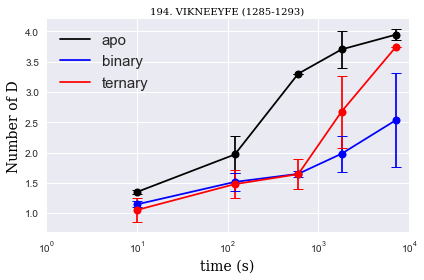

In [9]:
# Plotting all the uptake plots in terms of "D"

with PdfPages('FnCas12a_uptake_plots_D.pdf') as pdf: 
    
    peptides = [i for i in df1['pepn_idx'].unique()]

    for idx, p in zip(df1.idx_pep.unique(), peptides) :
        df2 = df1.loc[idx]

    # Create data

        a = (df2['Deut Time (sec)'], df2['#D_apo'])

        b = (df2['Deut Time (sec)'], df2['#D_bi'])

        c = (df2['Deut Time (sec)'], df2['#D_tr'])

        #plt.errorbar(x, y, yerr=e, fmt='o')
        a_std =  df2['Stddev_apo'].values.tolist()
        b_std =  df2['Stddev_bi'].values.tolist()
        c_std =  df2['Stddev_tr'].values.tolist()

        errors = (a_std, b_std, c_std)

        data = (a, b, c)
        colors = ("black", "blue", "red")
        groups = ("apo",  "binary", "ternary") 

        # Create plot
        fig = plt.figure()
        ax = fig.add_subplot(1, 1,1)
        ax.set_xscale('log')

        for data, color, group, error in zip(data, colors, groups, errors):
            x, y = data
            ax.scatter(x, y, c=color, edgecolors='none', s=30, label = None )
            ax.plot(x,y,c=color, label = group)

            (_, caps, _) = ax.errorbar(x, y, yerr=error, fmt='o', markersize=8, capsize=5, label = None, c= color)

            for cap in caps:
                cap.set_markeredgewidth(1)


        plt.xlim(1, 10000)
        #plt.ylim(ymin=0)

        font = {'family': 'serif','color':  'black', 'weight': 'normal','size': 14}
        font_t = {'family': 'serif','color':  'black', 'weight': 'normal','size': 10}
        plt.rc("font") 


        plt.xlabel('time (s)', fontdict = font)
        plt.ylabel("Number of D",fontdict = font)


        plt.title(p ,fontdict = font_t)
        plt.legend(fontsize = 15,loc=2)


        plt.tight_layout()


        pdf.savefig()
        plt.show()



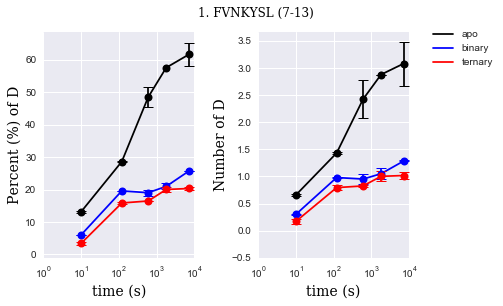

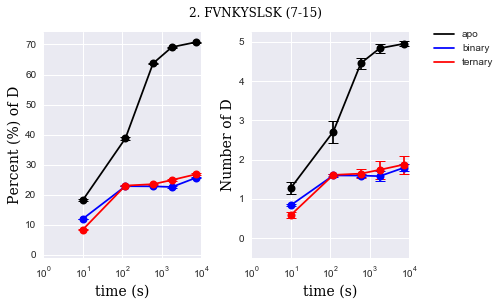

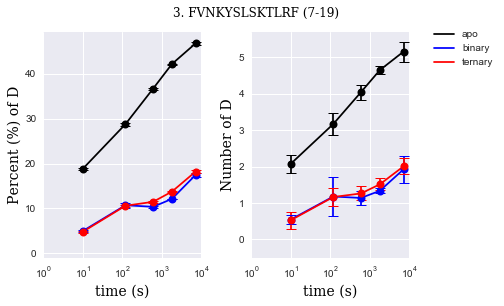

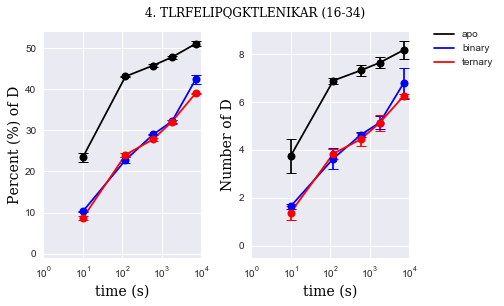

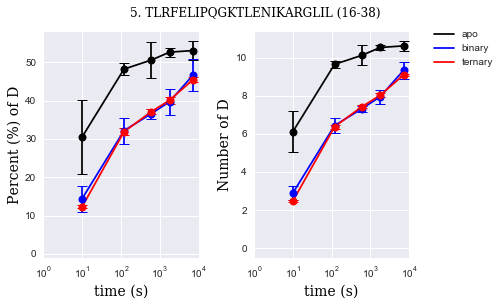

...

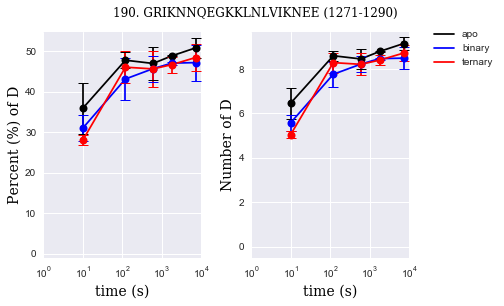

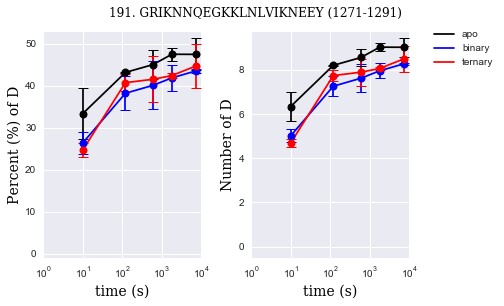

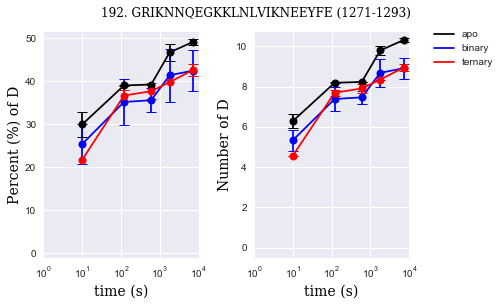

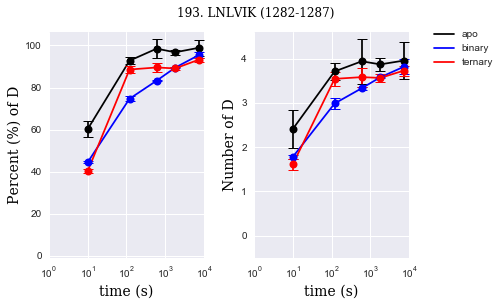

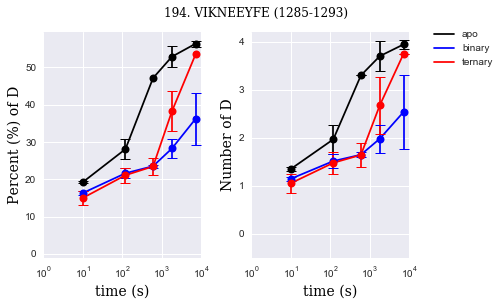

In [80]:
### Plotting all the uptake plots in terms of "#D" and %D"

with PdfPages('FnCas12a_uptake_plots_percent__and_Number_D.pdf') as pdf: 
    
    peptides = [i for i in df1['pepn_idx'].unique()]

    for idx, p in zip(df1.idx_pep.unique(), peptides) :
        df2 = df1.loc[idx]

    # Create data number of D

        a = (df2['Deut Time (sec)'], df2['%D_apo'])
        b = (df2['Deut Time (sec)'], df2['%D_bi'])
        c = (df2['Deut Time (sec)'], df2['%D_tr'])
        
    # Create data percent of D  
        a1 = (df2['Deut Time (sec)'], df2['#D_apo'])
        b1 = (df2['Deut Time (sec)'], df2['#D_bi'])
        c1 = (df2['Deut Time (sec)'], df2['#D_tr'])
        

        #plt.errorbar(x, y, yerr=e, fmt='o')
        a_std =  df2['Stddev_apo'].values.tolist()
        b_std =  df2['Stddev_bi'].values.tolist()
        c_std =  df2['Stddev_tr'].values.tolist()
        
        # Error for the percent plot
        a_p =  df2['Conf Interval (#D)_apo'].values.tolist()
        b_p =  df2['Conf Interval (#D)_bi'].values.tolist()
        c_p =  df2['Conf Interval (#D)_tr'].values.tolist()
        
        errors = (a_std, b_std, c_std)
        errors_p = (a_p, b_p, c_p)

        data = (a, b, c)
        data1 = (a1, b1, c1)
        
        colors = ("black", "blue", "red")
        groups = ("apo",  "binary", "ternary") 

        # Create plot

        f, (ax1, ax2) = plt.subplots(1, 2 )

        
        # Ploting % plot
        
        for data, color, group, error in zip(data, colors, groups, errors_p):
            x, y = data
            ax1.scatter(x, y, c=color, edgecolors='none', s=30, label = None )
            ax1.plot(x,y,c=color, label = group)

            (_, caps, _) = ax1.errorbar(x, y, yerr=error, fmt='o', markersize=8, capsize=5, label = None, c= color)

            for cap in caps:
                cap.set_markeredgewidth(1)
        
        # Plotting the #D plot        
        
        for data1, color, group, error in zip(data1, colors, groups, errors):
            x, y = data1
            ax2.scatter(x, y, c=color, edgecolors='none', s=30, label = None )
            ax2.plot(x,y,c=color, label = group)

            (_, caps, _) = ax2.errorbar(x, y, yerr=error, fmt='o', markersize=8, capsize=5, label = None, c= color)

            for cap in caps:
                cap.set_markeredgewidth(1)

        ax1.set_xscale('log')
        ax2.set_xscale('log')
        
        ax1.set_xlim(1, 10000)
        ax2.set_xlim(1, 10000)

        
        ax1.set_ylim(ymin=-1)
        ax2.set_ylim(ymin=-0.5)
        

        font = {'family': 'serif','color':  'black', 'weight': 'normal','size': 14}
        font_t = {'family': 'serif','color':  'black', 'weight': 'normal','size': 10}
        plt.rc("font")
         


        ax1.set_xlabel('time (s)', fontdict = font)
        ax2.set_xlabel('time (s)', fontdict = font)
        
        ax1.set_ylabel("Percent (%) of D",fontdict = font)
        ax2.set_ylabel("Number of D",fontdict = font)

        
        
        # Setting a common Legend out of the box
        legend = plt.legend(fontsize = 10, bbox_to_anchor=(1.1, 1.05))
        
        
        title = plt.suptitle(p, x = 0.6, y=1.05, fontdict = font_t)
        
        
        fig.tight_layout()
        plt.tight_layout()

        pdf.savefig(dpi=300, bbox_extra_artists=(legend, title), bbox_inches='tight')

        
        plt.savefig("HDX_PLOTS/"+ p + ".tif", dpi=300, bbox_extra_artists=(legend, title), bbox_inches='tight' )        
        
        plt.show()


In [84]:
df1.loc[120][["Conf Interval (#D)_tr", 'Stddev_tr' ]]

,Conf Interval (#D)_tr,Stddev_tr
idx_pep,,
120,0.285,0.179
120,0.300,0.189
120,0.357,0.225
120,0.450,0.283
120,0.529,0.332


In [ ]:
    
    peptides = [i for i in df1['pepn_idx'].unique()]

    for idx, p in zip(df1.idx_pep.unique(), peptides) :
        df2 = df1.loc[idx]

    # Create data number of D

        a = (df2['Deut Time (sec)'], df2['%D_apo'])
        b = (df2['Deut Time (sec)'], df2['%D_bi'])
        c = (df2['Deut Time (sec)'], df2['%D_tr'])
        
    # Create data percent of D  
        a1 = (df2['Deut Time (sec)'], df2['#D_apo'])
        b1 = (df2['Deut Time (sec)'], df2['#D_bi'])
        c1 = (df2['Deut Time (sec)'], df2['#D_tr'])
        

        # Error for the #D plot
        a_std =  df2['Stddev_apo'].values.tolist()
        b_std =  df2['Stddev_bi'].values.tolist()
        c_std =  df2['Stddev_tr'].values.tolist()
        
        # Error for the percent plot interms of Confidence Interval (95%)
        a_p =  df2['Conf Interval (#D)_apo'].values.tolist()
        b_p =  df2['Conf Interval (#D)_bi'].values.tolist()
        c_p =  df2['Conf Interval (#D)_tr'].values.tolist()

        errors = (a_std, b_std, c_std)
        errors_p = (a_p, b_p, c_p)

        data = (a, b, c)
        data1 = (a1, b1, c1)
        
        colors = ("black", "blue", "red")
        groups = ("apo",  "binary", "ternary") 

        # Create plot
        f, (ax1, ax2) = plt.subplots(1, 2 )
        
         # Plotting the %D plot 
        for data, color, group, error in zip(data, colors, groups, errors_p):
            x, y = data
            ax1.scatter(x, y, c=color, edgecolors='none', s=30, label = None )
            ax1.plot(x,y,c=color, label = group)

            (_, caps, _) = ax1.errorbar(x, y, yerr=error, fmt='o', markersize=8, capsize=5, label = None, c= color)

            for cap in caps:
                cap.set_markeredgewidth(1)
        
        # Plotting the #D plot        
        
        for data1, color, group, error in zip(data1, colors, groups, errors):
            x, y = data1
            ax2.scatter(x, y, c=color, edgecolors='none', s=30, label = None )
            ax2.plot(x,y,c=color, label = group)

            (_, caps, _) = ax2.errorbar(x, y, yerr=error, fmt='o', markersize=8, capsize=5, label = None, c= color)

            for cap in caps:
                cap.set_markeredgewidth(1)

        ax1.set_xscale('log')
        ax2.set_xscale('log')
        
        ax1.set_xlim(1, 10000)
        ax2.set_xlim(1, 10000)

        
        plt.ylim(ymin=0.00)

        font = {'family': 'serif','color':  'black', 'weight': 'normal','size': 14}
        font_t = {'family': 'serif','color':  'black', 'weight': 'normal','size': 10}
        plt.rc("font")
         


        ax1.set_xlabel('time (s)', fontdict = font)
        ax2.set_xlabel('time (s)', fontdict = font)
        
        ax1.set_ylabel("Percent (%) of D",fontdict = font)
        ax2.set_ylabel("Number of D",fontdict = font)

        
        
        # Setting a common Legend out of the box
        lgd = plt.legend(fontsize = 15, bbox_to_anchor=(1.1, 1.05))
        
        
        title = plt.suptitle(p, x = 0.6, y=1.05, fontdict = font_t)
        #plt.title(p ,fontdict = font_t)
        
        fig.tight_layout()
        plt.tight_layout()

        plt.savefig("HDX_PLOTS/"+ p + ".tif", dpi=300, bbox_extra_artists=(lgd, title), bbox_inches='tight' )
        plt.show()


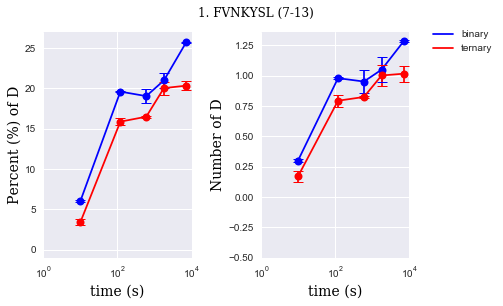

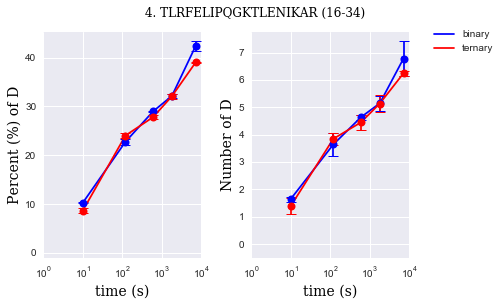

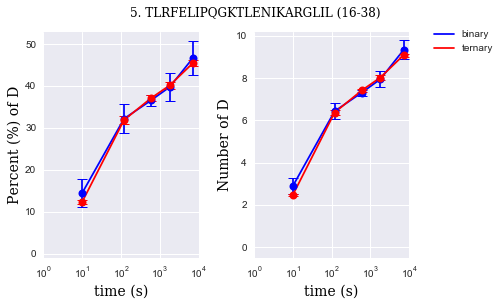

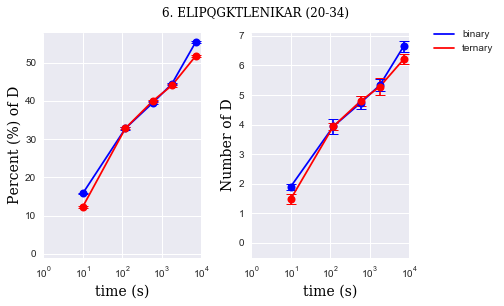

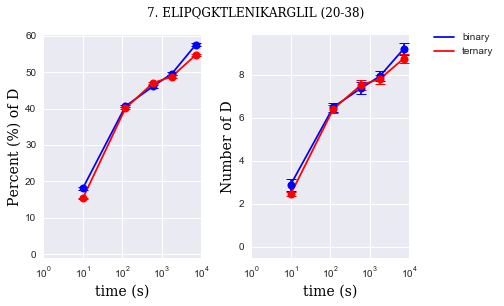

...

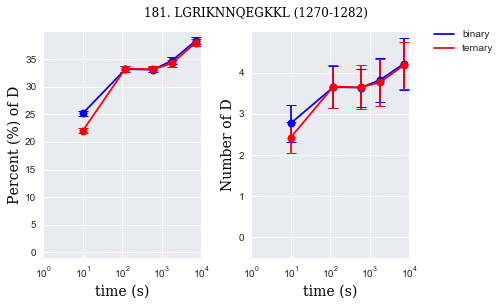

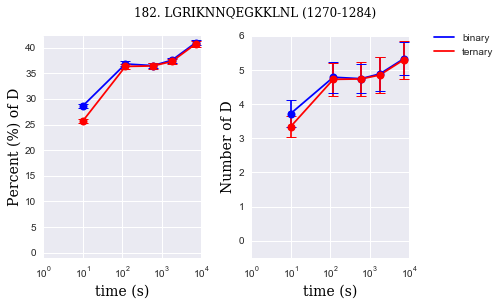

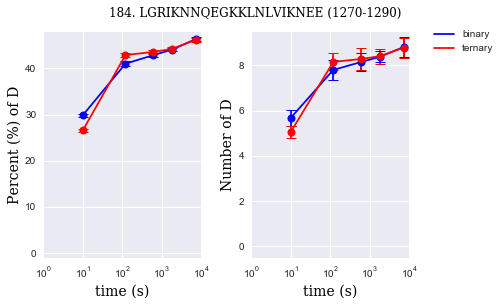

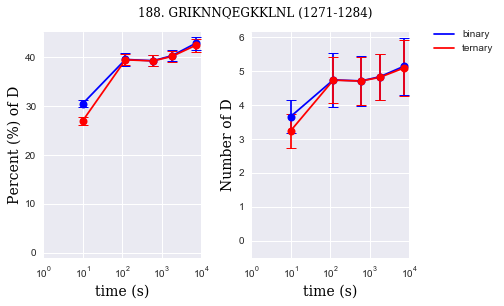

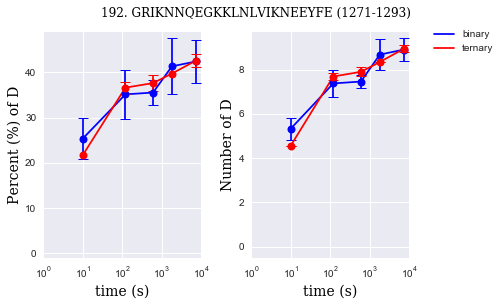

In [50]:
### Plotting the uptake plots for positive or neutral changes

with PdfPages('d(b,t)_pos.pdf') as pdf: 
    
    for idx, p in zip(pos_pep_idx, pos_pep) :
        df2 = df1.loc[idx]

    # Create data number of D

        #a = (df2['Deut Time (sec)'], df2['%D_apo'])
        b = (df2['Deut Time (sec)'], df2['%D_bi'])
        c = (df2['Deut Time (sec)'], df2['%D_tr'])
        
    # Create data percent of D  
        #a1 = (df2['Deut Time (sec)'], df2['#D_apo'])
        b1 = (df2['Deut Time (sec)'], df2['#D_bi'])
        c1 = (df2['Deut Time (sec)'], df2['#D_tr'])
        

        #plt.errorbar(x, y, yerr=e, fmt='o')
        #a_std =  df2['Stddev_apo'].values.tolist()
        b_std =  df2['Stddev_bi'].values.tolist()
        c_std =  df2['Stddev_tr'].values.tolist()
        
        # Error for the percent plot
        #a_p =  df2['Conf Interval (#D)_apo'].values.tolist()
        b_p =  df2['Conf Interval (#D)_bi'].values.tolist()
        c_p =  df2['Conf Interval (#D)_tr'].values.tolist()
        
        errors = (b_std, c_std)
        errors_p = (b_p, c_p)

        data = (b, c)
        data1 = (b1, c1)
        
        colors = ("blue", "red")
        groups = ("binary", "ternary") 

        # Create plot

        f, (ax1, ax2) = plt.subplots(1, 2 )

        
        # Ploting % plot
        
        for data, color, group, error in zip(data, colors, groups, errors_p):
            x, y = data
            ax1.scatter(x, y, c=color, edgecolors='none', s=30, label = None )
            ax1.plot(x,y,c=color, label = group)

            (_, caps, _) = ax1.errorbar(x, y, yerr=error, fmt='o', markersize=8, capsize=5, label = None, c= color)

            for cap in caps:
                cap.set_markeredgewidth(1)
        
        # Plotting the #D plot        
        
        for data1, color, group, error in zip(data1, colors, groups, errors):
            x, y = data1
            ax2.scatter(x, y, c=color, edgecolors='none', s=30, label = None )
            ax2.plot(x,y,c=color, label = group)

            (_, caps, _) = ax2.errorbar(x, y, yerr=error, fmt='o', markersize=8, capsize=5, label = None, c= color)

            for cap in caps:
                cap.set_markeredgewidth(1)

        ax1.set_xscale('log')
        ax2.set_xscale('log')
        
        ax1.set_xlim(1, 10000)
        ax2.set_xlim(1, 10000)

        
        ax1.set_ylim(ymin=-1)
        ax2.set_ylim(ymin=-0.5)
        

        font = {'family': 'serif','color':  'black', 'weight': 'normal','size': 14}
        font_t = {'family': 'serif','color':  'black', 'weight': 'normal','size': 10}
        plt.rc("font")
         


        ax1.set_xlabel('time (s)', fontdict = font)
        ax2.set_xlabel('time (s)', fontdict = font)
        
        ax1.set_ylabel("Percent (%) of D",fontdict = font)
        ax2.set_ylabel("Number of D",fontdict = font)

        
        
        # Setting a common Legend out of the box
        legend = plt.legend(fontsize = 10, bbox_to_anchor=(1.1, 1.05))
        
        
        title = plt.suptitle(p, x = 0.6, y=1.05, fontdict = font_t)
        
        
        f.tight_layout()
        plt.tight_layout()

        pdf.savefig(dpi=300, bbox_extra_artists=(legend, title), bbox_inches='tight')

        
        #plt.savefig("HDX_PLOTS/"+ p + ".tif", dpi=300, bbox_extra_artists=(legend, title), bbox_inches='tight' )        
        
        plt.show()


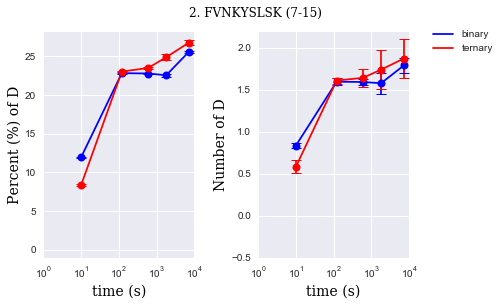

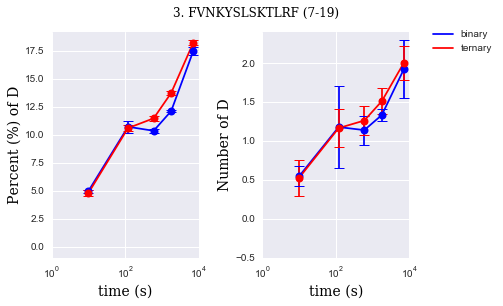

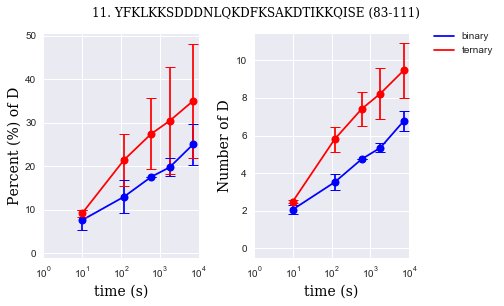

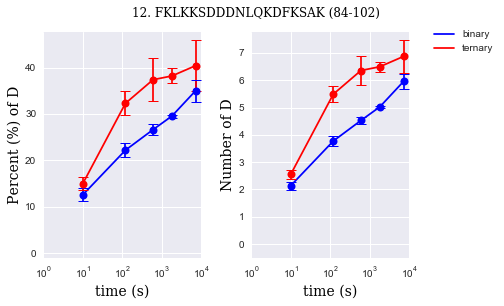

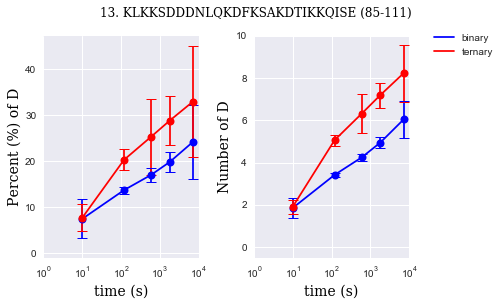

...

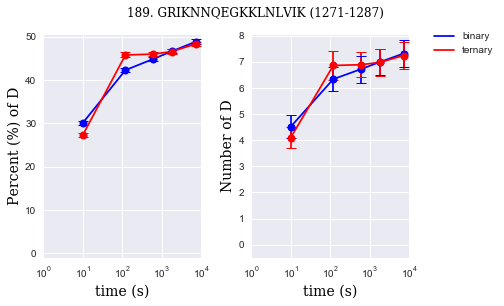

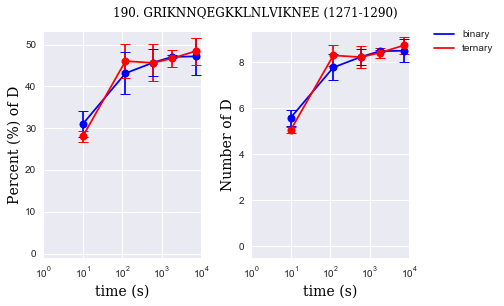

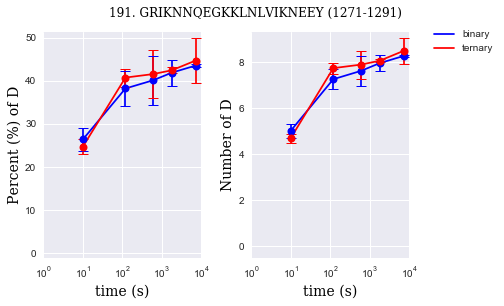

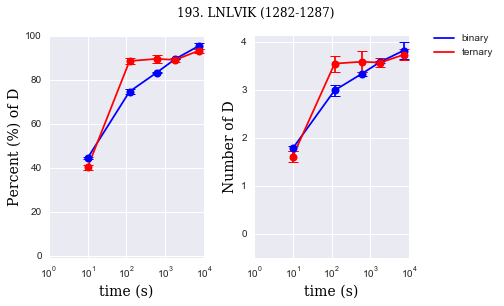

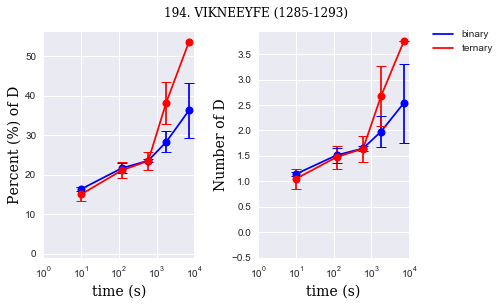

In [53]:
### Plotting the uptake plots for negative or neutral changes

with PdfPages('d(b,t)_neg.pdf') as pdf: 
    
    for idx, p in zip(neg_pep_idx, neg_pep):
        df2 = df1.loc[idx]

    # Create data number of D

        #a = (df2['Deut Time (sec)'], df2['%D_apo'])
        b = (df2['Deut Time (sec)'], df2['%D_bi'])
        c = (df2['Deut Time (sec)'], df2['%D_tr'])
        
    # Create data percent of D  
        #a1 = (df2['Deut Time (sec)'], df2['#D_apo'])
        b1 = (df2['Deut Time (sec)'], df2['#D_bi'])
        c1 = (df2['Deut Time (sec)'], df2['#D_tr'])
        

        #plt.errorbar(x, y, yerr=e, fmt='o')
        #a_std =  df2['Stddev_apo'].values.tolist()
        b_std =  df2['Stddev_bi'].values.tolist()
        c_std =  df2['Stddev_tr'].values.tolist()
        
        # Error for the percent plot
        #a_p =  df2['Conf Interval (#D)_apo'].values.tolist()
        b_p =  df2['Conf Interval (#D)_bi'].values.tolist()
        c_p =  df2['Conf Interval (#D)_tr'].values.tolist()
        
        errors = (b_std, c_std)
        errors_p = (b_p, c_p)

        data = (b, c)
        data1 = (b1, c1)
        
        colors = ("blue", "red")
        groups = ("binary", "ternary") 

        # Create plot

        f, (ax1, ax2) = plt.subplots(1, 2 )

        
        # Ploting % plot
        
        for data, color, group, error in zip(data, colors, groups, errors_p):
            x, y = data
            ax1.scatter(x, y, c=color, edgecolors='none', s=30, label = None )
            ax1.plot(x,y,c=color, label = group)

            (_, caps, _) = ax1.errorbar(x, y, yerr=error, fmt='o', markersize=8, capsize=5, label = None, c= color)

            for cap in caps:
                cap.set_markeredgewidth(1)
        
        # Plotting the #D plot        
        
        for data1, color, group, error in zip(data1, colors, groups, errors):
            x, y = data1
            ax2.scatter(x, y, c=color, edgecolors='none', s=30, label = None )
            ax2.plot(x,y,c=color, label = group)

            (_, caps, _) = ax2.errorbar(x, y, yerr=error, fmt='o', markersize=8, capsize=5, label = None, c= color)

            for cap in caps:
                cap.set_markeredgewidth(1)

        ax1.set_xscale('log')
        ax2.set_xscale('log')
        
        ax1.set_xlim(1, 10000)
        ax2.set_xlim(1, 10000)

        
        ax1.set_ylim(ymin=-1)
        ax2.set_ylim(ymin=-0.5)
        

        font = {'family': 'serif','color':  'black', 'weight': 'normal','size': 14}
        font_t = {'family': 'serif','color':  'black', 'weight': 'normal','size': 10}
        plt.rc("font")
         


        ax1.set_xlabel('time (s)', fontdict = font)
        ax2.set_xlabel('time (s)', fontdict = font)
        
        ax1.set_ylabel("Percent (%) of D",fontdict = font)
        ax2.set_ylabel("Number of D",fontdict = font)

        
        
        # Setting a common Legend out of the box
        legend = plt.legend(fontsize = 10, bbox_to_anchor=(1.1, 1.05))
        
        
        title = plt.suptitle(p, x = 0.6, y=1.05, fontdict = font_t)
        
        
        f.tight_layout()
        plt.tight_layout()

        pdf.savefig(dpi=300, bbox_extra_artists=(legend, title), bbox_inches='tight')

        
        #plt.savefig("HDX_PLOTS/"+ p + ".tif", dpi=300, bbox_extra_artists=(legend, title), bbox_inches='tight' )        
        
        plt.show()


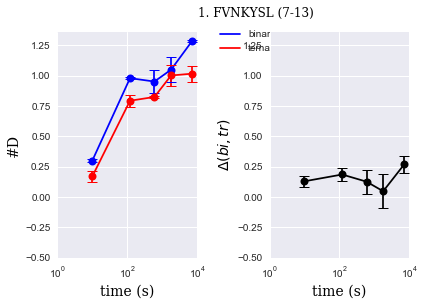

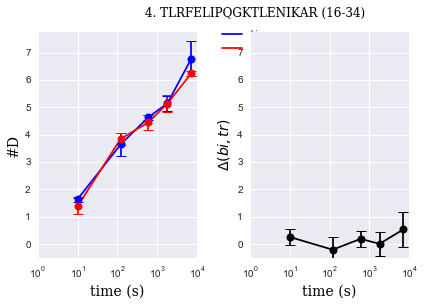

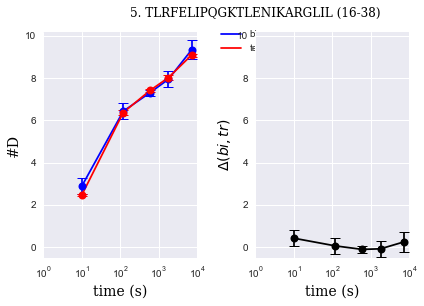

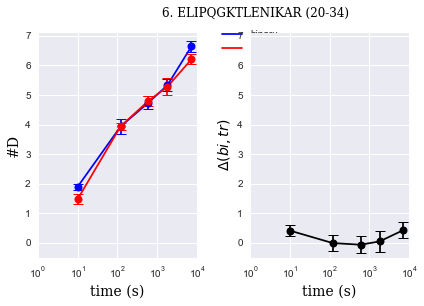

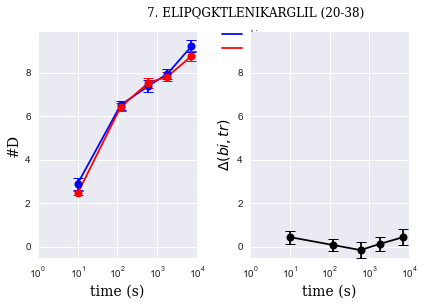

...

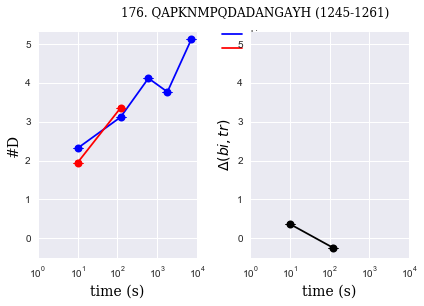

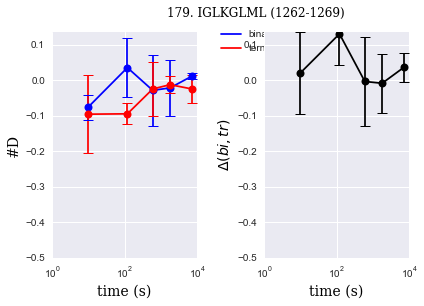

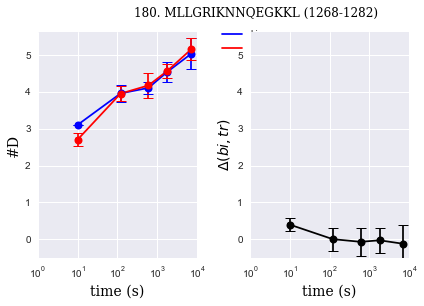

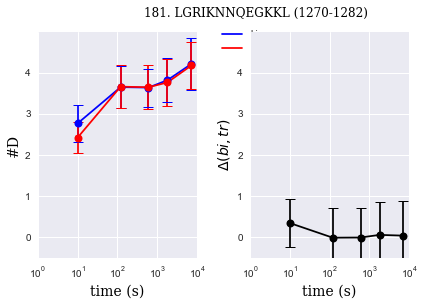

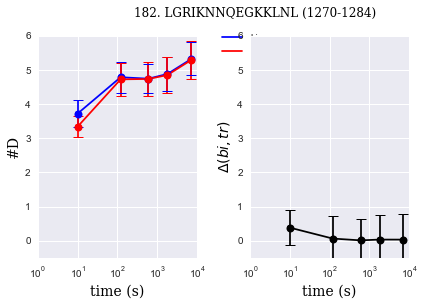

KeyboardInterrupt: 

In [ ]:
### Now plotting the uptake plots  and differences for positive or neutral changes

with PdfPages('d(b,t)_pos.pdf') as pdf: 
    
    for idx, p in zip(pos_pep_idx, pos_pep):
        df2 = df1.loc[idx]


    # Create data percent of D  
        #a1 = (df2['Deut Time (sec)'], df2['#D_apo'])
        b = (df2['Deut Time (sec)'], df2['#D_bi'])
        c = (df2['Deut Time (sec)'], df2['#D_tr'])
        
    # Create data number of D

        #a = (df2['Deut Time (sec)'], df2['%D_apo'])
        db = (df2['Deut Time (sec)'], df2['delta(b,t)'])
        
        #a_std =  df2['Stddev_apo'].values.tolist()
        b_std =  df2['Stddev_bi'].values.tolist()
        c_std =  df2['Stddev_tr'].values.tolist()
        
        # Error for the differences

        db_std =  df2['delta(b,t),std'].values.tolist()

        
        errors = (b_std, c_std)
        

        
        data = (b, c)
        
        colors = ("blue", "red")
        groups = ("binary", "ternary") 

        # Create plot

        f, (ax1, ax2) = plt.subplots(1, 2 )

        
        # Ploting #D plot
        
        for data, color, group, error in zip(data, colors, groups, errors):
            x, y = data
            ax1.scatter(x, y, c=color, edgecolors='none', s=30, label = None )
            ax1.plot(x,y,c=color, label = group)

            (_, caps, _) = ax1.errorbar(x, y, yerr=error, fmt='o', markersize=8, capsize=5, label = None, c= color)

            for cap in caps:
                cap.set_markeredgewidth(1)
        
        # Plotting the differences       

        x, y = db
        ax2.scatter(x, y, c='black', edgecolors='none', s=30, label = None )
        ax2.plot(x,y,c='black', label = group)

        (_, caps, _) = ax2.errorbar(x, y, yerr=db_std, fmt='o', markersize=8, capsize=5, label = None, c= "black")

        for cap in caps:
            cap.set_markeredgewidth(1)

        ax1.set_xscale('log')
        ax2.set_xscale('log')
        
        ax1.set_xlim(1, 10000)
        ax2.set_xlim(1, 10000)

        
        ax1_min, ax1_max = ax1.set_ylim(-0.5)
        ax2.set_ylim(ax1_min, ax1_max)
        

        font = {'family': 'serif','color':  'black', 'weight': 'normal','size': 14}
        font_t = {'family': 'serif','color':  'black', 'weight': 'normal','size': 10}
        plt.rc("font")
         


        ax1.set_xlabel('time (s)', fontdict = font)
        ax2.set_xlabel('time (s)', fontdict = font)
        
        ax1.set_ylabel("#D",fontdict = font)
        ax2.set_ylabel("$\Delta (bi,tr)$",fontdict = font)

        
        
        # Setting a common Legend out of the box
        legend = ax1.legend(fontsize = 10, bbox_to_anchor=(1.1, 1.05))
        
        
        title = plt.suptitle(p, x = 0.6, y=1.05, fontdict = font_t)
        
        
        f.tight_layout()
        plt.tight_layout()

        pdf.savefig(dpi=300, bbox_extra_artists=(legend, title), bbox_inches='tight')

        
        #plt.savefig("HDX_PLOTS/"+ p + ".tif", dpi=300, bbox_extra_artists=(legend, title), bbox_inches='tight' )        
        
        plt.show()


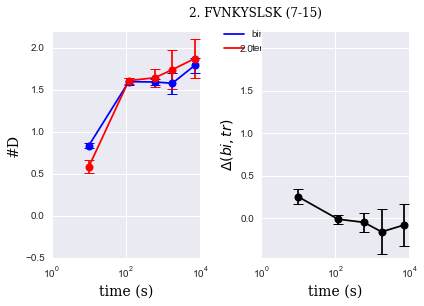

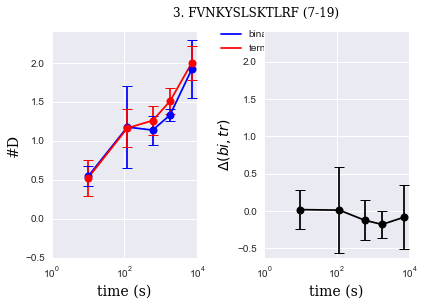

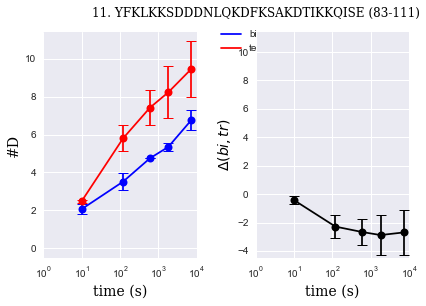

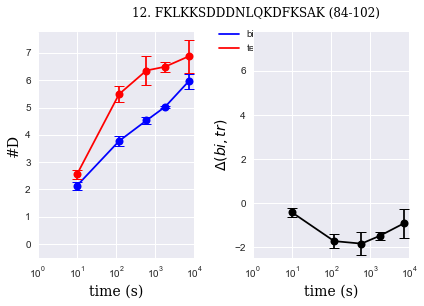

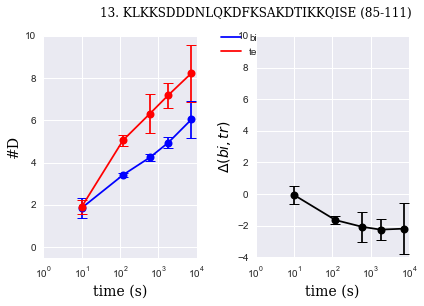

...

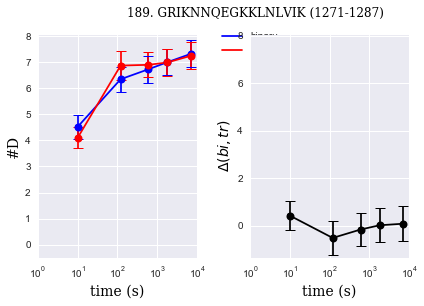

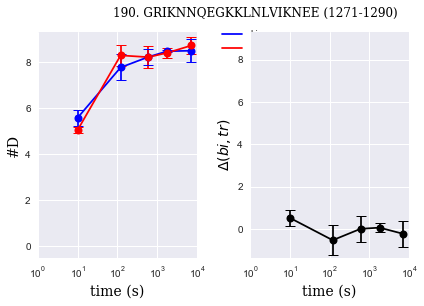

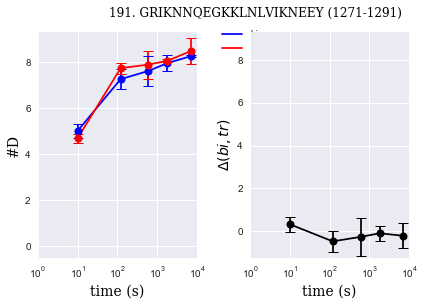

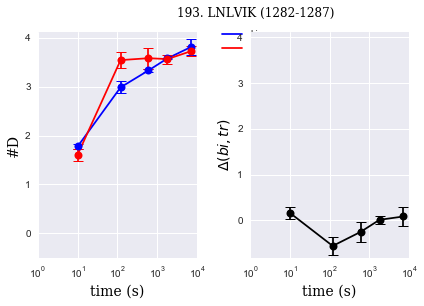

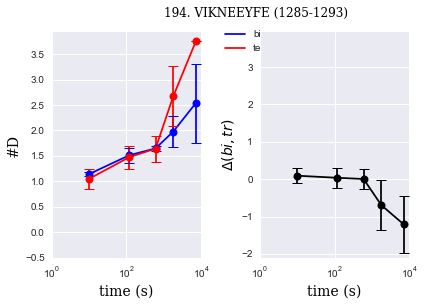

In [12]:
### Now plotting the uptake plots  and differences for negative or neutral changes

with PdfPages('d(b,t)_neg.pdf') as pdf: 
    
    for idx, p in zip(neg_pep_idx, neg_pep):
        df2 = df1.loc[idx]


    # Create data percent of D  
        #a1 = (df2['Deut Time (sec)'], df2['#D_apo'])
        b = (df2['Deut Time (sec)'], df2['#D_bi'])
        c = (df2['Deut Time (sec)'], df2['#D_tr'])
        
    # Create data number of D

        #a = (df2['Deut Time (sec)'], df2['%D_apo'])
        db = (df2['Deut Time (sec)'], df2['delta(b,t)'])
        
        #a_std =  df2['Stddev_apo'].values.tolist()
        b_std =  df2['Stddev_bi'].values.tolist()
        c_std =  df2['Stddev_tr'].values.tolist()
        
        # Error for the differences

        db_std =  df2['delta(b,t),std'].values.tolist()

        
        errors = (b_std, c_std)
        

        
        data = (b, c)
        
        colors = ("blue", "red")
        groups = ("binary", "ternary") 

        # Create plot

        f, (ax1, ax2) = plt.subplots(1, 2 )

        
        # Ploting #D plot
        
        for data, color, group, error in zip(data, colors, groups, errors):
            x, y = data
            ax1.scatter(x, y, c=color, edgecolors='none', s=30, label = None )
            ax1.plot(x,y,c=color, label = group)

            (_, caps, _) = ax1.errorbar(x, y, yerr=error, fmt='o', markersize=8, capsize=5, label = None, c= color)

            for cap in caps:
                cap.set_markeredgewidth(1)
        
        # Plotting the differences       

        x, y = db
        ax2.scatter(x, y, c='black', edgecolors='none', s=30, label = None )
        ax2.plot(x,y,c='black', label = group)

        (_, caps, _) = ax2.errorbar(x, y, yerr=db_std, fmt='o', markersize=8, capsize=5, label = None, c= "black")

        for cap in caps:
            cap.set_markeredgewidth(1)

        ax1.set_xscale('log')
        ax2.set_xscale('log')
        
        ax1.set_xlim(1, 10000)
        ax2.set_xlim(1, 10000)

        
        ax1_min, ax1_max = ax1.set_ylim(-0.5)
        ax2.set_ylim(ymax= ax1_max)
        

        font = {'family': 'serif','color':  'black', 'weight': 'normal','size': 14}
        font_t = {'family': 'serif','color':  'black', 'weight': 'normal','size': 10}
        plt.rc("font")
         


        ax1.set_xlabel('time (s)', fontdict = font)
        ax2.set_xlabel('time (s)', fontdict = font)
        
        ax1.set_ylabel("#D",fontdict = font)
        ax2.set_ylabel("$\Delta (bi,tr)$",fontdict = font)

        
        
        # Setting a common Legend out of the box
        legend = ax1.legend(fontsize = 10, bbox_to_anchor=(1.1, 1.05))
        
        
        title = plt.suptitle(p, x = 0.6, y=1.05, fontdict = font_t)
        
        
        f.tight_layout()
        plt.tight_layout()

        pdf.savefig(dpi=300, bbox_extra_artists=(legend, title), bbox_inches='tight')

        
        #plt.savefig("HDX_PLOTS/"+ p + ".tif", dpi=300, bbox_extra_artists=(legend, title), bbox_inches='tight' )        
        
        plt.show()


In [13]:
df1_pos = df1[df1.groupby("idx_pep")["#D_bi", "#D_tr"].mean()['#D_bi']>df1.groupby("idx_pep")["#D_bi", "#D_tr"].mean()['#D_tr']]
df1_neg= df1[df1.groupby("idx_pep")["#D_bi", "#D_tr"].mean()['#D_bi']<df1.groupby("idx_pep")["#D_bi", "#D_tr"].mean()['#D_tr']]


/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: 'idx_pep' is both a column name and an index level.
Defaulting to column but this will raise an ambiguity error in a future version
  """Entry point for launching an IPython kernel.
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: 'idx_pep' is both a column name and an index level.
Defaulting to column but this will raise an ambiguity error in a future version
  
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


In [58]:
df1_pos.columns

Index(['Start', 'End', 'Sequence', 'Deut Time (sec)', 'maxD', '#D_apo',
       '%D_apo', 'Conf Interval (#D)_apo', '#Pts_apo', 'Confidence_apo',
       'Stddev_apo', 'p_apo', '#D_bi', '%D_bi', 'Conf Interval (#D)_bi',
       '#Pts_bi', 'Confidence_bi', 'Stddev_bi', 'p_bi', '#D_tr', '%D_tr',
       'Conf Interval (#D)_tr', '#Pts_tr', 'Confidence_tr', 'Stddev_tr',
       'p_tr', 'idx_pep', 'pepn_idx', 'delta(b,t)', 'delta(b,t),std'],
      dtype='object')

/anaconda3/lib/python3.6/site-packages/seaborn/categorical.py:1460: FutureWarning: remove_na is deprecated and is a private function. Do not use.
  stat_data = remove_na(group_data)


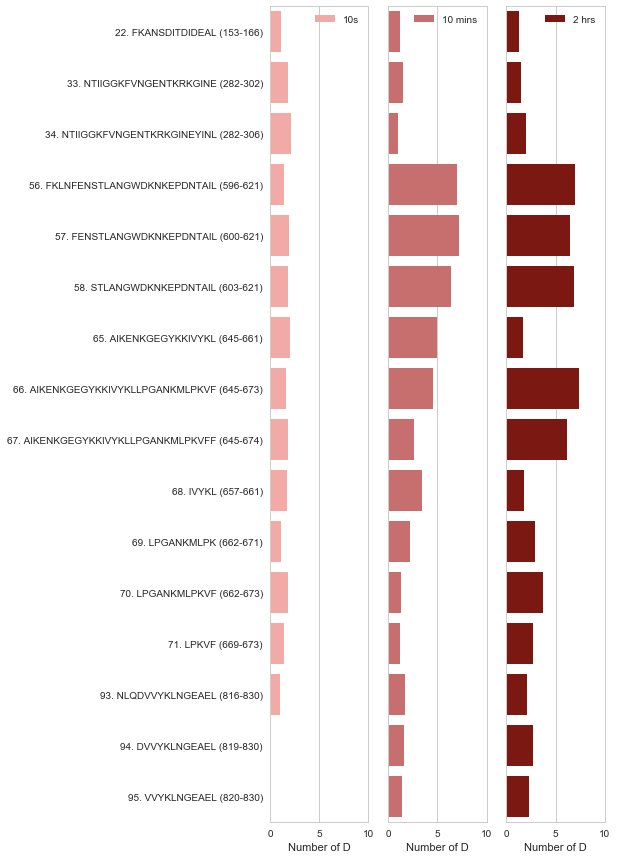

In [215]:
# Initialize the matplotlib figure
f, (ax1,ax2,ax3) = plt.subplots(ncols=3, figsize=(6, 15),sharey =True)
sns.set(style="whitegrid")

# Plot the t= 10s 
sns.set_color_codes("pastel")
ax1 = sns.barplot(x='delta(b,t)', y='pepn_idx', data=df1_pos1[df1_pos1['Deut Time (sec)'] ==10],
             label = "10s", color="r", dodge =False, ax =ax1)


# Plot the t= 10mins
sns.set_color_codes("muted")
ax2 = sns.barplot(x='delta(b,t)', y='pepn_idx', data=df1_pos1[df1_pos1['Deut Time (sec)'] ==600],
            color="r", label = "10 mins", dodge =False, ax =ax2)

# Plot the t= 2 hrs
sns.set_color_codes("dark")
ax3 =sns.barplot(x='delta(b,t)',y='pepn_idx', data=df1_pos1[df1_pos1['Deut Time (sec)'] ==7200],
             color="r", label = "2 hrs" ,dodge =False, ax = ax3)


# Add a legend and informative axis label
for ax in ax1,ax2,ax3:
    
    ax.legend(loc= "upper right", frameon=False)
    ax.set(xlim=(0, 10), ylabel="",xlabel ="Number of D")
    #ax.set_xticks(range(1,11))
    #ax.set_xax
#sns.despine(left=True, bottom=True)

#plt.tight_layout()
plt.savefig("barplot.pdf", dpi=500, bbox_extra_artists=(ax1,ax2,ax3), bbox_inches='tight')






In [ ]:
plt.subplot()

/anaconda3/lib/python3.6/site-packages/seaborn/categorical.py:1460: FutureWarning: remove_na is deprecated and is a private function. Do not use.
  stat_data = remove_na(group_data)


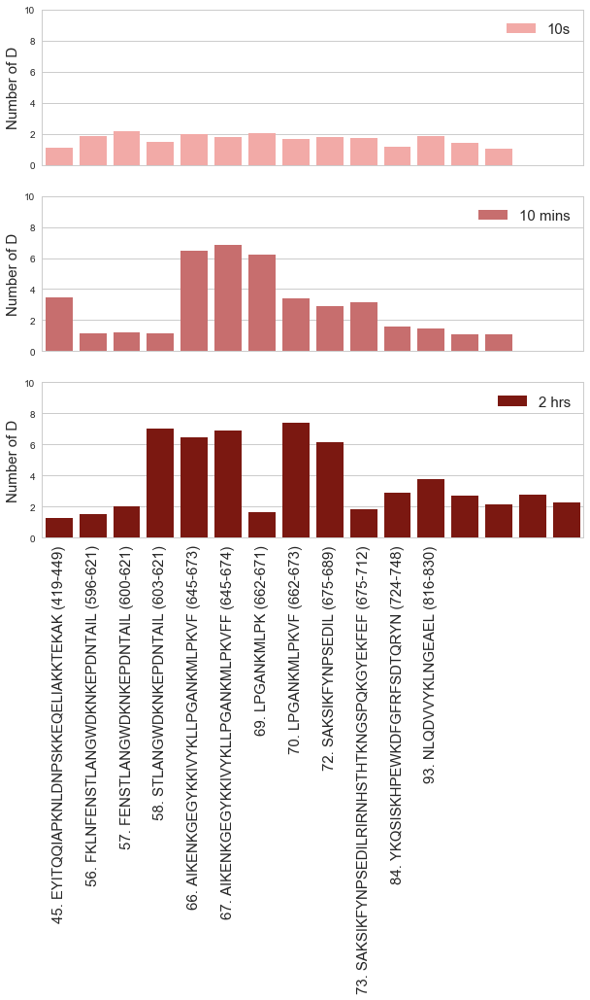

In [259]:
# Initialize the matplotlib figure
f, (ax1,ax2,ax3) = plt.subplots(nrows=3, figsize=(10, 10),sharex= True,sharey =True)
sns.set(style="whitegrid")

# Plot the t= 10s 
sns.set_color_codes("pastel")
ax1 = sns.barplot(y='delta(b,t)', x='pepn_idx', data=df1_pos1[df1_pos1['Deut Time (sec)'] ==10],
             label = "10s", color="r", dodge =False, ax =ax1)
ax1.set_xticks([])

# Plot the t= 10mins
sns.set_color_codes("muted")
ax2 = sns.barplot(y='delta(b,t)', x='pepn_idx', data=df1_pos1[df1_pos1['Deut Time (sec)'] ==120],
            color="r", label = "10 mins", dodge =False, ax =ax2)
ax2.set_xticks([])

# Plot the t= 2 hrs
sns.set_color_codes("dark")
ax3 =sns.barplot(y='delta(b,t)',x='pepn_idx', data=df1_pos1[df1_pos1['Deut Time (sec)'] ==7200],
             color="r", label = "2 hrs" ,dodge =False, ax = ax3)


# Add a legend and informative axis label
axis_label=df1_pos1[df1_pos1['Deut Time (sec)'] ==10].pepn_idx.tolist()

for ax in ax1,ax2,ax3:
    
    ax.legend(loc= "upper right", frameon=False,fontsize=15)
    ax.set(ylim=(0, 10), xlabel="")

for ax in ax1,ax2,ax3:
    ax.set_ylabel("Number of D",fontsize=15)

locs, labels = plt.xticks()

plt.xticks(np.arange(12), axis_label, rotation=90, fontsize=15)
#plt.xls(axis_label, rotation=90, ha="right", fontsize=15)

#sns.despine(left=True, bottom=True)

#plt.tight_layout()
plt.savefig("barplot1.pdf", dpi=500, bbox_extra_artists=(ax1,ax2,ax3), bbox_inches='tight')



In [245]:
len(df1_pos1[df1_pos1['Deut Time (sec)'] ==600].pepn_idx.tolist())

16

In [177]:
df1_pos[df1_pos['Deut Time (sec)'] ==10].sort_values('delta(b,t)', ascending=False)

,Start,End,Sequence,Deut Time (sec),maxD,#D_apo,%D_apo,Conf Interval (#D)_apo,#Pts_apo,Confidence_apo,...,%D_tr,Conf Interval (#D)_tr,#Pts_tr,Confidence_tr,Stddev_tr,p_tr,idx_pep,pepn_idx,"delta(b,t)","delta(b,t),std"
idx_pep,,,,,,,,,,,,,,,,,,,,,
57,600,621,FENSTLANGWDKNKEPDNTAIL,10,19,6.163,32.435,1.071,4.0,Medium,...,4.951,0.826,4.0,Medium,0.519,0.000028,57,57. FENSTLANGWDKNKEPDNTAIL (600-621),2.170,0.649802
69,662,671,LPGANKMLPK,10,7,2.599,37.130,5.710,2.0,Medium,...,3.552,1.416,2.0,Medium,0.158,0.103885,69,69. LPGANKMLPK (662-671),2.033,0.208471
66,645,673,AIKENKGEGYKKIVYKLLPGANKMLPKVF,10,25,3.302,13.207,6.015,2.0,Medium,...,3.591,1.147,2.0,Medium,0.128,0.113421,66,66. AIKENKGEGYKKIVYKLLPGANKMLPKVF (645-673),1.977,0.283537
93,816,830,NLQDVVYKLNGEAEL,10,13,3.510,27.001,6.066,2.0,Medium,...,8.092,3.185,2.0,Medium,0.354,0.073594,93,93. NLQDVVYKLNGEAEL (816-830),1.871,0.599643
56,596,621,FKLNFENSTLANGWDKNKEPDNTAIL,10,23,6.517,28.335,9.987,2.0,Medium,...,3.978,2.876,2.0,Medium,0.320,0.069749,56,56. FKLNFENSTLANGWDKNKEPDNTAIL (596-621),1.830,0.394081
67,645,674,AIKENKGEGYKKIVYKLLPGANKMLPKVFF,10,26,3.911,15.044,3.737,2.0,Medium,...,4.717,0.870,2.0,Medium,0.097,0.057575,67,67. AIKENKGEGYKKIVYKLLPGANKMLPKVFF (645-674),1.812,0.345880
72,675,689,SAKSIKFYNPSEDIL,10,12,4.037,33.645,6.225,2.0,Medium,...,17.178,0.908,2.0,Medium,0.101,0.148088,72,72. SAKSIKFYNPSEDIL (675-689),1.809,0.101000
73,675,712,SAKSIKFYNPSEDILRIRNHSTHTKNGSPQKGYEKFEF,10,34,5.812,17.094,7.827,2.0,High,...,10.225,0.850,2.0,High,0.095,0.160222,73,73. SAKSIKFYNPSEDILRIRNHSTHTKNGSPQKGYEKFEF (67...,1.713,0.575890
70,662,673,LPGANKMLPKVF,10,9,2.637,29.305,0.426,4.0,Medium,...,5.099,0.101,4.0,Medium,0.063,0.000297,70,70. LPGANKMLPKVF (662-673),1.680,0.167314


/anaconda3/lib/python3.6/site-packages/seaborn/categorical.py:1460: FutureWarning: remove_na is deprecated and is a private function. Do not use.
  stat_data = remove_na(group_data)
No handles with labels found to put in legend.


[Text(0,0,'1. FVNKYSL (7-13)'),
 Text(1,0,'4. TLRFELIPQGKTLENIKAR (16-34)'),
 Text(2,0,'5. TLRFELIPQGKTLENIKARGLIL (16-38)'),
 Text(3,0,'6. ELIPQGKTLENIKAR (20-34)'),
 Text(4,0,'7. ELIPQGKTLENIKARGLIL (20-38)'),
 Text(5,0,'8. IPQGKTLENIKAR (22-34)'),
 Text(6,0,'9. DDEKRAKDYKKAKQIIDKYHQF (39-60)'),
 Text(7,0,'10. DDEKRAKDYKKAKQIIDKYHQFFIEE (39-64)'),
 Text(8,0,'14. FKNLFNQNL (119-127)'),
 Text(9,0,'16. FKNLFNQNLIDAKKGQESDL (119-138)'),
 Text(10,0,'17. LILWLKQSKDNGIEL (138-152)'),
 Text(11,0,'20. FKANSDITDID (153-163)'),
 Text(12,0,'21. FKANSDITDIDE (153-164)'),
 Text(13,0,'22. FKANSDITDIDEAL (153-166)'),
 Text(14,0,'26. YEQIKKDLAEE (231-241)'),
 Text(15,0,'29. DIDYKTSEVNQRVFSL (245-260)'),
 Text(16,0,'30. YKTSEVNQRVF (248-258)'),
 Text(17,0,'33. NTIIGGKFVNGENTKRKGINE (282-302)'),
 Text(18,0,'34. NTIIGGKFVNGENTKRKGINEYINL (282-306)'),
 Text(19,0,'35. FVNGENTKRKGINE (289-302)'),
 Text(20,0,'36. LYSQQINDK (306-314)'),
 Text(21,0,'45. EYITQQIAPKNLDNPSKKEQELIAKKTEKAK (419-449)'),
 Text(22,0,

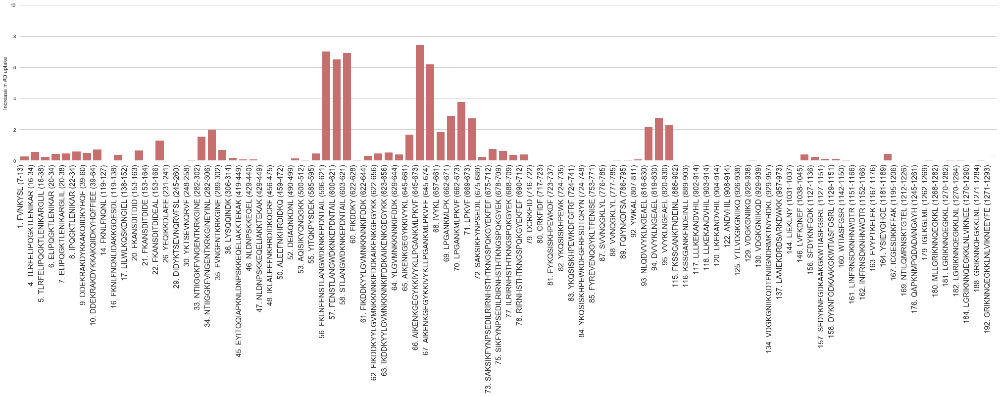

In [126]:
# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(30,5))

#data=df1_pos[df1_pos['Deut Time (sec)'] ==10].sort_values('delta(b,t)', ascending=False)
# Plot the total crashes
sns.set_color_codes("muted")
pt = sns.barplot( x='pepn_idx',y='delta(b,t)',
                 data=df1_pos[df1_pos['Deut Time (sec)'] ==7200],
                 
                 color="r", dodge =False)


# Plot the crashes where alcohol was involved
#sns.set_color_codes("pastel")
#sns.barplot(x='delta(b,t)', y='pepn_idx', data=df1_pos[df1_pos['Deut Time (sec)'] ==7200].sort_values('delta(b,t)', ascending=False),
            #label='pepn_idx', color="b")

# Add a legend and informative axis label
ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(ylim=(0, 10),xlabel="", ylabel ='Increase in #D uptake')
sns.despine(left=True, bottom=True)
plt.tight_layout()
pt.set_xticklabels(s_10, rotation=90, ha="right", fontsize=15)

In [109]:
s_10 = df1_pos.pepn_idx[df1_pos['Deut Time (sec)'] ==10].tolist()

In [198]:
df1_pos.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 470 entries, 1 to 192
Data columns (total 30 columns):
Start                     470 non-null int64
End                       470 non-null int64
Sequence                  470 non-null object
Deut Time (sec)           470 non-null category
maxD                      470 non-null int64
#D_apo                    453 non-null float64
%D_apo                    453 non-null float64
Conf Interval (#D)_apo    422 non-null float64
#Pts_apo                  453 non-null float64
Confidence_apo            453 non-null object
Stddev_apo                453 non-null float64
p_apo                     0 non-null float64
#D_bi                     458 non-null float64
%D_bi                     458 non-null float64
Conf Interval (#D)_bi     422 non-null float64
#Pts_bi                   458 non-null float64
Confidence_bi             458 non-null object
Stddev_bi                 458 non-null float64
p_bi                      419 non-null float64
#D_tr       

In [179]:
df1_pos['Deut Time (sec)'] = df1_pos['Deut Time (sec)'].astype("category")
df1_pos['pepn_idx']= df1_pos['pepn_idx'].astype("object")

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [12]:
df1_pos[(df1_pos["delta(b,t)"].round(1)>df1_pos["delta(b,t),std"].round(1)) & (df1_pos["delta(b,t)"].round(1)>1) ]


NameError: name 'df1_pos' is not defined

In [214]:
df1_pos1 = df1_pos[(df1_pos["delta(b,t)"].round(1)>df1_pos["delta(b,t),std"].round(1)) & (df1_pos["delta(b,t)"].round(1)>1) ]
df1_pos1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 76 entries, 21 to 157
Data columns (total 30 columns):
Start                     76 non-null int64
End                       76 non-null int64
Sequence                  76 non-null object
Deut Time (sec)           76 non-null category
maxD                      76 non-null int64
#D_apo                    71 non-null float64
%D_apo                    71 non-null float64
Conf Interval (#D)_apo    67 non-null float64
#Pts_apo                  71 non-null float64
Confidence_apo            71 non-null object
Stddev_apo                71 non-null float64
p_apo                     0 non-null float64
#D_bi                     76 non-null float64
%D_bi                     76 non-null float64
Conf Interval (#D)_bi     66 non-null float64
#Pts_bi                   76 non-null float64
Confidence_bi             76 non-null object
Stddev_bi                 76 non-null float64
p_bi                      65 non-null float64
#D_tr                     76 n

In [136]:
tips = sns.load_dataset("tips")
tips.head(), tips.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 244 entries, 0 to 243
Data columns (total 7 columns):
total_bill    244 non-null float64
tip           244 non-null float64
sex           244 non-null category
smoker        244 non-null category
day           244 non-null category
time          244 non-null category
size          244 non-null int64
dtypes: category(4), float64(2), int64(1)
memory usage: 7.2 KB


(   total_bill   tip     sex smoker  day    time  size
 0       16.99  1.01  Female     No  Sun  Dinner     2
 1       10.34  1.66    Male     No  Sun  Dinner     3
 2       21.01  3.50    Male     No  Sun  Dinner     3
 3       23.68  3.31    Male     No  Sun  Dinner     2
 4       24.59  3.61  Female     No  Sun  Dinner     4, None)

/anaconda3/lib/python3.6/site-packages/seaborn/categorical.py:1460: FutureWarning: remove_na is deprecated and is a private function. Do not use.
  stat_data = remove_na(group_data)


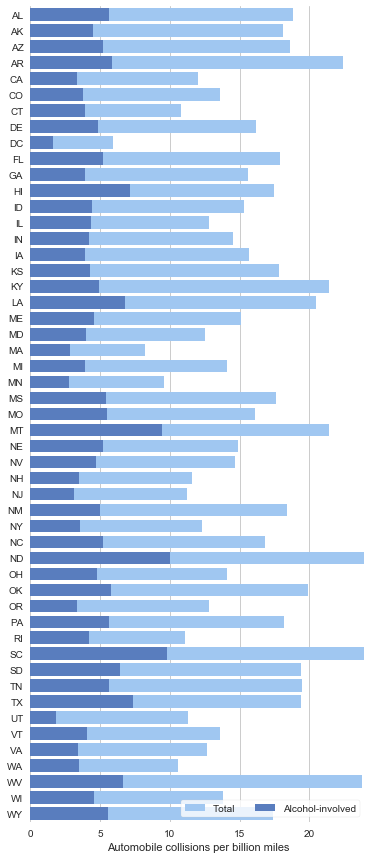

In [20]:
# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(6, 15))

# Load the example car crash dataset
crashes = sns.load_dataset("car_crashes")#.sort_values("total", ascending=False)

# Plot the total crashes
sns.set_color_codes("pastel")
sns.barplot(x="total", y="abbrev", data=crashes,
            label="Total", color="b")

# Plot the crashes where alcohol was involved
sns.set_color_codes("muted")
sns.barplot(x="alcohol", y="abbrev", data=crashes,
            label="Alcohol-involved", color="b")

# Add a legend and informative axis label
ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(xlim=(0, 24), ylabel="",
       xlabel="Automobile collisions per billion miles")
sns.despine(left=True, bottom=True)